In [1]:
import os
import numpy as np

## Визуализация работы нейросети

In [2]:
from keras.layers import Layer
from keras.engine import Layer, InputSpec
from keras import initializers
from keras import regularizers
from keras import constraints
from keras import backend as K
from keras.legacy import interfaces

class MyBatchNormalization(Layer):
    """Batch normalization layer (Ioffe and Szegedy, 2014).
    Normalize the activations of the previous layer at each batch,
    i.e. applies a transformation that maintains the mean activation
    close to 0 and the activation standard deviation close to 1.
    # Arguments
        axis: Integer, the axis that should be normalized
            (typically the features axis).
            For instance, after a `Conv2D` layer with
            `data_format="channels_first"`,
            set `axis=1` in `BatchNormalization`.
        momentum: Momentum for the moving mean and the moving variance.
        epsilon: Small float added to variance to avoid dividing by zero.
        center: If True, add offset of `beta` to normalized tensor.
            If False, `beta` is ignored.
        scale: If True, multiply by `gamma`.
            If False, `gamma` is not used.
            When the next layer is linear (also e.g. `nn.relu`),
            this can be disabled since the scaling
            will be done by the next layer.
        beta_initializer: Initializer for the beta weight.
        gamma_initializer: Initializer for the gamma weight.
        moving_mean_initializer: Initializer for the moving mean.
        moving_variance_initializer: Initializer for the moving variance.
        beta_regularizer: Optional regularizer for the beta weight.
        gamma_regularizer: Optional regularizer for the gamma weight.
        beta_constraint: Optional constraint for the beta weight.
        gamma_constraint: Optional constraint for the gamma weight.
    # Input shape
        Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
    # Output shape
        Same shape as input.
    # References
        - [Batch Normalization: Accelerating Deep Network Training by Reducing Internal Covariate Shift](https://arxiv.org/abs/1502.03167)
    """

    @interfaces.legacy_batchnorm_support
    def __init__(self,
                 axis=-1,
                 momentum=0.99,
                 epsilon=1e-3,
                 center=True,
                 scale=True,
                 beta_initializer='zeros',
                 gamma_initializer='ones',
                 moving_mean_initializer='zeros',
                 moving_variance_initializer='ones',
                 beta_regularizer=None,
                 gamma_regularizer=None,
                 beta_constraint=None,
                 gamma_constraint=None,
                 **kwargs):
        self._trainable = True
        self._trainable_tensor = K.variable(1, dtype='float32', name='trainable')
        super(MyBatchNormalization, self).__init__(**kwargs)
        self.supports_masking = True
        self.axis = axis
        self.momentum = momentum
        self.epsilon = epsilon
        self.center = center
        self.scale = scale
        self.beta_initializer = initializers.get(beta_initializer)
        self.gamma_initializer = initializers.get(gamma_initializer)
        self.moving_mean_initializer = initializers.get(moving_mean_initializer)
        self.moving_variance_initializer = initializers.get(moving_variance_initializer)
        self.beta_regularizer = regularizers.get(beta_regularizer)
        self.gamma_regularizer = regularizers.get(gamma_regularizer)
        self.beta_constraint = constraints.get(beta_constraint)
        self.gamma_constraint = constraints.get(gamma_constraint)

    @property
    def trainable(self):
        # Use cached value to avoid unnecessary get_value() calls
        return self._trainable

    @trainable.setter
    def trainable(self, trainable):
        trainable = bool(trainable)
        # Change when different to avoid unnecessary set_value() calls
        if self._trainable != trainable:
            self._trainable = trainable
            K.set_value(self._trainable_tensor, 1 if trainable else 0)

    def build(self, input_shape):
        dim = input_shape[self.axis]
        if dim is None:
            raise ValueError('Axis ' + str(self.axis) + ' of '
                             'input tensor should have a defined dimension '
                             'but the layer received an input with shape ' +
                             str(input_shape) + '.')
        self.input_spec = InputSpec(ndim=len(input_shape),
                                    axes={self.axis: dim})
        shape = (dim,)

        if self.scale:
            self.gamma = self.add_weight(shape=shape,
                                         name='gamma',
                                         initializer=self.gamma_initializer,
                                         regularizer=self.gamma_regularizer,
                                         constraint=self.gamma_constraint)
        else:
            self.gamma = None
        if self.center:
            self.beta = self.add_weight(shape=shape,
                                        name='beta',
                                        initializer=self.beta_initializer,
                                        regularizer=self.beta_regularizer,
                                        constraint=self.beta_constraint)
        else:
            self.beta = None
        self.moving_mean = self.add_weight(
            shape=shape,
            name='moving_mean',
            initializer=self.moving_mean_initializer,
            trainable=False)
        self.moving_variance = self.add_weight(
            shape=shape,
            name='moving_variance',
            initializer=self.moving_variance_initializer,
            trainable=False)
        self.built = True

    def call(self, inputs, training=None):
        input_shape = K.int_shape(inputs)
        # Prepare broadcasting shape.
        ndim = len(input_shape)
        reduction_axes = list(range(len(input_shape)))
        del reduction_axes[self.axis]
        broadcast_shape = [1] * len(input_shape)
        broadcast_shape[self.axis] = input_shape[self.axis]

        # Determines whether broadcasting is needed.
        needs_broadcasting = (sorted(reduction_axes) != list(range(ndim))[:-1])

        def normalize_inference():
            if needs_broadcasting:
                # In this case we must explicitly broadcast all parameters.
                broadcast_moving_mean = K.reshape(self.moving_mean,
                                                  broadcast_shape)
                broadcast_moving_variance = K.reshape(self.moving_variance,
                                                      broadcast_shape)
                if self.center:
                    broadcast_beta = K.reshape(self.beta, broadcast_shape)
                else:
                    broadcast_beta = None
                if self.scale:
                    broadcast_gamma = K.reshape(self.gamma,
                                                broadcast_shape)
                else:
                    broadcast_gamma = None
                return K.batch_normalization(
                    inputs,
                    broadcast_moving_mean,
                    broadcast_moving_variance,
                    broadcast_beta,
                    broadcast_gamma,
                    epsilon=self.epsilon)
            else:
                return K.batch_normalization(
                    inputs,
                    self.moving_mean,
                    self.moving_variance,
                    self.beta,
                    self.gamma,
                    epsilon=self.epsilon)

        if training in {0, False}:
            # If the learning phase is *static* and set to inference:
            return normalize_inference()
        elif training is None:
            # If it's undefined then if tensor is on respect learning phase else set to false
            training = K.switch(self._trainable_tensor, K.cast(K.learning_phase(), 'float32'),
                                K.constant(0, dtype='float32'))
            training._uses_learning_phase = True

        # If the learning is either dynamic, or set to training:
        normed_training, mean, variance = K.normalize_batch_in_training(
            inputs, self.gamma, self.beta, reduction_axes,
            epsilon=self.epsilon)

        if K.backend() != 'cntk':
            sample_size = K.prod([K.shape(inputs)[axis]
                                  for axis in reduction_axes])
            sample_size = K.cast(sample_size, dtype=K.dtype(inputs))

            # sample variance - unbiased estimator of population variance
            variance *= sample_size / (sample_size - (1.0 + self.epsilon))

        self.add_update([K.moving_average_update(self.moving_mean,
                                                 mean,
                                                 self.momentum),
                         K.moving_average_update(self.moving_variance,
                                                 variance,
                                                 self.momentum)],
                        inputs)

        # Pick the normalized form corresponding to the training phase.
        return K.in_train_phase(normed_training,
                                normalize_inference,
                                training=training)

    def get_config(self):
        config = {
            'axis': self.axis,
            'momentum': self.momentum,
            'epsilon': self.epsilon,
            'center': self.center,
            'scale': self.scale,
            'beta_initializer': initializers.serialize(self.beta_initializer),
            'gamma_initializer': initializers.serialize(self.gamma_initializer),
            'moving_mean_initializer': initializers.serialize(self.moving_mean_initializer),
            'moving_variance_initializer': initializers.serialize(self.moving_variance_initializer),
            'beta_regularizer': regularizers.serialize(self.beta_regularizer),
            'gamma_regularizer': regularizers.serialize(self.gamma_regularizer),
            'beta_constraint': constraints.serialize(self.beta_constraint),
            'gamma_constraint': constraints.serialize(self.gamma_constraint)
        }
        base_config = super(MyBatchNormalization, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

    def compute_output_shape(self, input_shape):
        return input_shape

Using TensorFlow backend.


In [3]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [4]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_fullsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [6]:
import tensorflow as tf

In [7]:
def berhu_loss(labels, predictions, delta=1.0):
    error = tf.abs(labels - predictions)
    loss = tf.where(error < delta,
                    error,
                    (error ** 2 + delta ** 2) / (2 * delta)
                   )
    return tf.reduce_mean(loss)

In [8]:
from keras.models import load_model
model = load_model('model_on_epoch6.hdf5', 
                   custom_objects={'MyBatchNormalization': MyBatchNormalization,
                                   'berhu_loss': berhu_loss
                                  }
                  )

### Обучающая выборка

In [14]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [15]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [16]:
sq_diff = (train_prediction - depths_train_sample) ** 2

In [17]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.04508945099544271


In [18]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

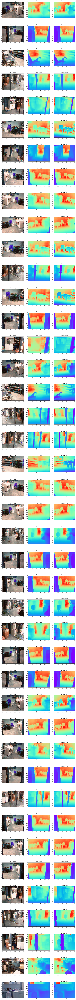

In [19]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [20]:
rgbs_val_sample = np.array(rgbs_val)
depths_val_sample = np.array(depths_val)

In [21]:
%%time
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

CPU times: user 2min 18s, sys: 1min 9s, total: 3min 27s
Wall time: 3min 20s


In [22]:
sq_diff = (val_prediction - depths_val_sample) ** 2

In [23]:
sq_diff.shape

(14266, 384, 512)

In [24]:
print('MSE when depth < 1m:',
      sq_diff[depths_val_sample < 1].sum() / (depths_val_sample < 1).sum())
target_depths = np.logical_and(depths_val_sample > 1, depths_val_sample < 2)
print('MSE when depth is between 1m and 2m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = np.logical_and(depths_val_sample > 2, depths_val_sample < 5)
print('MSE when depth is between 2m and 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = (depths_val_sample > 5)
print('MSE when depth > 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())

MSE when depth < 1m: 0.6523836703345341
MSE when depth is between 1m and 2m: 0.2635225153148152
MSE when depth is between 2m and 5m: 0.3193278783430664
MSE when depth > 5m: 1.8796165286120334


In [25]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))

validation MSE: 0.4778877128682918


In [26]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [27]:
rgbs_val_sample = rgbs_val_sample[::534]
depths_val_sample = depths_val_sample[::534]
val_prediction_sample = val_prediction[::534]

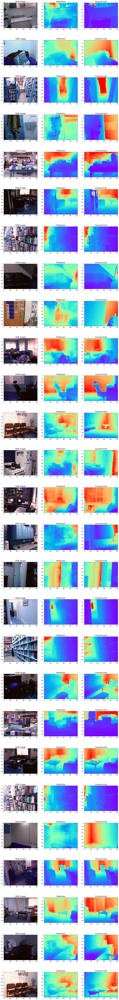

In [28]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: другие коллекции

In [29]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [ ]:
%%time
test_prediction = model.predict(rgbs_test_sample, batch_size=32)

In [ ]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

In [ ]:
sq_diff = (test_prediction - depths_test_sample) ** 2

In [ ]:
print('MSE when depth < 1m:',
      sq_diff[depths_test_sample < 1].sum() / (depths_test_sample < 1).sum())
target_depths = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
print('MSE when depth is between 1m and 2m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
print('MSE when depth is between 2m and 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = (depths_test_sample > 5)
print('MSE when depth > 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())

In [34]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [35]:
rgbs_test_sample = rgbs_test_sample[::100]
depths_test_sample = depths_test_sample[::100]
test_prediction_sample = test_prediction[::100]

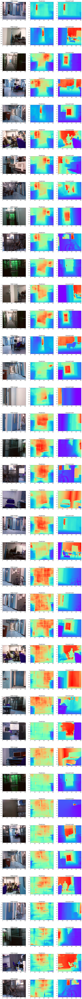

In [36]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

In [42]:
depths_test = np.array(depths_test)
depths_test[depths_test < 0.5] = 0.5

In [43]:
print('MSE between logarithms:', np.mean((np.log(depths_test) - np.log(test_prediction)) ** 2))

MSE between logarithms: 0.08346145047810548


### Сравнение с batch_size=1

In [21]:
for layer in model.layers:
    if layer.name.startswith('my_batch_normalization'):
        layer.trainable = False

In [22]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [23]:
%%time
test_prediction_single = model.predict(rgbs_test_sample, batch_size=1)

CPU times: user 1min 26s, sys: 27.3 s, total: 1min 53s
Wall time: 1min 45s


In [24]:
print('second-validation MSE:', np.mean((test_prediction_single - depths_test_sample) ** 2))

second-validation MSE: 0.627320209070045


In [25]:
sq_diff = (test_prediction_single - depths_test_sample) ** 2

In [26]:
print('MSE when depth < 1m:',
      sq_diff[depths_test_sample < 1].sum() / (depths_test_sample < 1).sum())
target_depths = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
print('MSE when depth is between 1m and 2m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
print('MSE when depth is between 2m and 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = (depths_test_sample > 5)
print('MSE when depth > 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())

MSE when depth < 1m: 0.8650434753819394
MSE when depth is between 1m and 2m: 0.42629229276487574
MSE when depth is between 2m and 5m: 0.37226601203090853
MSE when depth > 5m: 1.9567988988727434


Предсказания с разным batch_size различаются. Скорее всего, в MyBatchNormalization используется нормализация, а не заученные коэффициенты